# SNA Term Project
---
We consider multiple pages related to tourism and focus on whose follower list will be examined. That means that they are in the spotlight of this analysis. Those nodes are considered the `spotlight nodes`.

**References:**
- [Facebook Network Analysis](https://networkx.org/nx-guides/content/exploratory_notebooks/facebook_notebook.html#facebook-network-analysis)

In [1]:
from random import randint
from datetime import datetime

import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
edges_df = pd.read_csv(
    "../data/checkpoint/edges_v3.csv"
)
edges_df.info()
edges_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7239 entries, 0 to 7238
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   start_node  7239 non-null   object
 1   end_node    7239 non-null   object
 2   edge_type   7239 non-null   object
dtypes: object(3)
memory usage: 169.8+ KB


,start_node,end_node,edge_type
0,TripTH ทริปไทยแลนด์,Gluta Story,page-page
1,TripTH ทริปไทยแลนด์,บันทึกคนขี้เที่ยว,page-page
2,TripTH ทริปไทยแลนด์,จ ะ เ ที่ ย ว ไ ป ไ ห น,page-page
3,TripTH ทริปไทยแลนด์,อาสาพาไปหลง,page-page
4,TripTH ทริปไทยแลนด์,Pigkaploy,page-page
...,...,...,...
7234,Non Nuttawat,Sneak out หนีเที่ยว,user-page
7235,Praew Phattharaphorn,Sneak out หนีเที่ยว,user-page
7236,Thiprada Thipda,Sneak out หนีเที่ยว,user-page
7237,Bobby Panturat,Sneak out หนีเที่ยว,user-page


In [3]:
edges_df['edge_type'].value_counts()

edge_type
user-page    6956
page-page     283
Name: count, dtype: int64

## Construct Graph
---
Create a directed graph because the relationships have a direction (follower → page)

In [4]:
G = nx.DiGraph()

In [5]:
G.add_edges_from(zip(edges_df['start_node'], edges_df['end_node']))

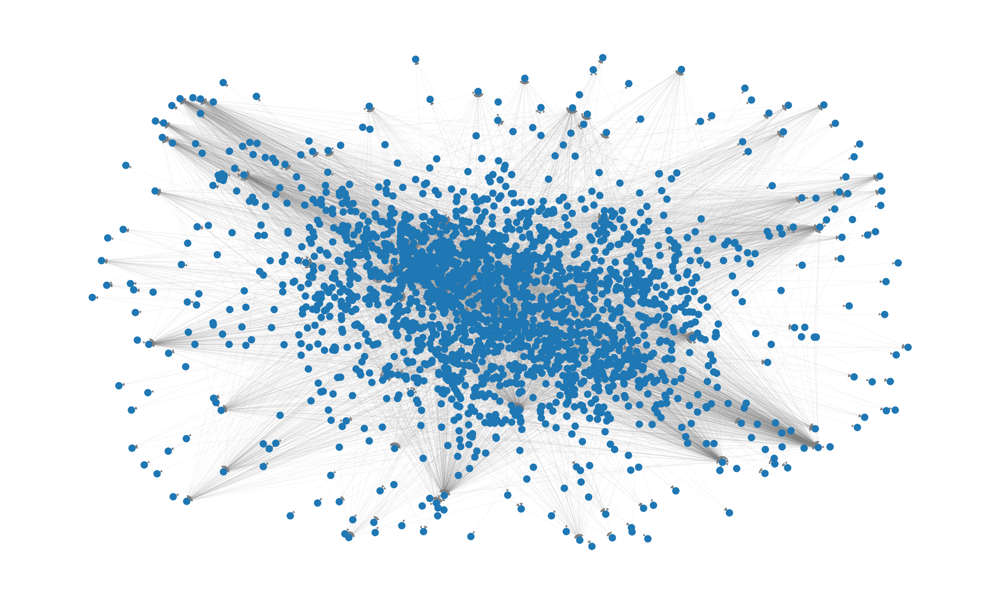

In [10]:
plt.figure(figsize=(15, 9))
pos = nx.spring_layout(G, iterations=15, seed=42)
nx.draw(
    G, 
    pos, 
    with_labels=False, 
    node_size=50, 
    node_color='tab:blue',
    edge_color='gray',
    arrowsize=7, # arrow head length
    width=0.05 # line width
)

## Analyze Network
---

### Basic Metrics

In [11]:
# Basic network properties
print(f"Number of nodes: {G.number_of_nodes()}")
print(f"Number of edges: {G.number_of_edges()}")
print(f"Density: {nx.density(G)}")

Number of nodes: 2399
Number of edges: 7239
Density: 0.0012583433255655245


Graph density is used to understand how interconnected the network is. 
The density is 0 for a graph without edges and 1 for a complete graph.

### Centrality Measure
- Degree Centrality: Identify highly connected nodes (pages with many followers).
- Betweenness Centrality: Find nodes that act as bridges between different parts of the network.
- Closeness Centrality: Identify nodes that can efficiently disseminate information.
- Eigenvector Centrality: Detect influential nodes connected to other influential nodes.

#### Degree Centrality

In [12]:
degree_centrality = nx.degree_centrality(G)

# Find top influencers based on degree centrality
top_degree_centrality = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print("Top influencers from degree centrality:")
top_degree_centrality

Top influencers from degree centrality:


[('I Roam Alone', 0.25521267723102586),
 ('TripTH ทริปไทยแลนด์', 0.25020850708924103),
 ('Unseen Tour Thailand', 0.16972477064220182),
 ('Sneak out หนีเที่ยว', 0.14595496246872394),
 ('Go Went Go', 0.1317764804003336)]

In [13]:
pd.Series(degree_centrality.values()).describe()

count    2399.000000
mean        0.002517
std         0.011416
min         0.000417
25%         0.000834
50%         0.001251
75%         0.001668
max         0.255213
dtype: float64

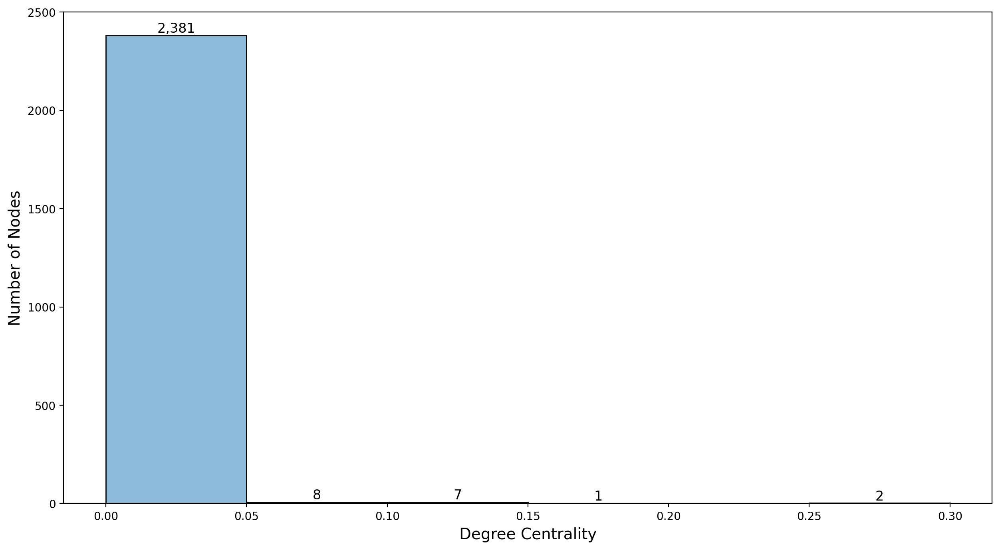

In [94]:
plt.figure(figsize=(15, 8))
ax = sns.histplot(data=degree_centrality.values(),
            binrange=(0, 0.3),
            binwidth=0.05)
# Adding value text on each bar
for p in ax.patches:
    height = p.get_height()
    if height > 0:  # Only annotate bars that have a height greater than 0
        ax.text(p.get_x() + p.get_width() / 2, height + 0.5, f'{int(height):,}', 
                ha='center', fontsize=12, color='black', va='bottom')

# # Adding a vertical line at x = 0.1
# plt.axvline(x=0.1, color='red', linestyle='--', linewidth=1)

# Setting axis labels
ax.set_xlabel("Degree Centrality", fontsize=14)
ax.set_ylabel("Number of Nodes", fontsize=14)
ax.get_legend().remove()

# # Setting x-tick labels every 0.05
# ax.set_xticks([i * 0.05 for i in range(11)])

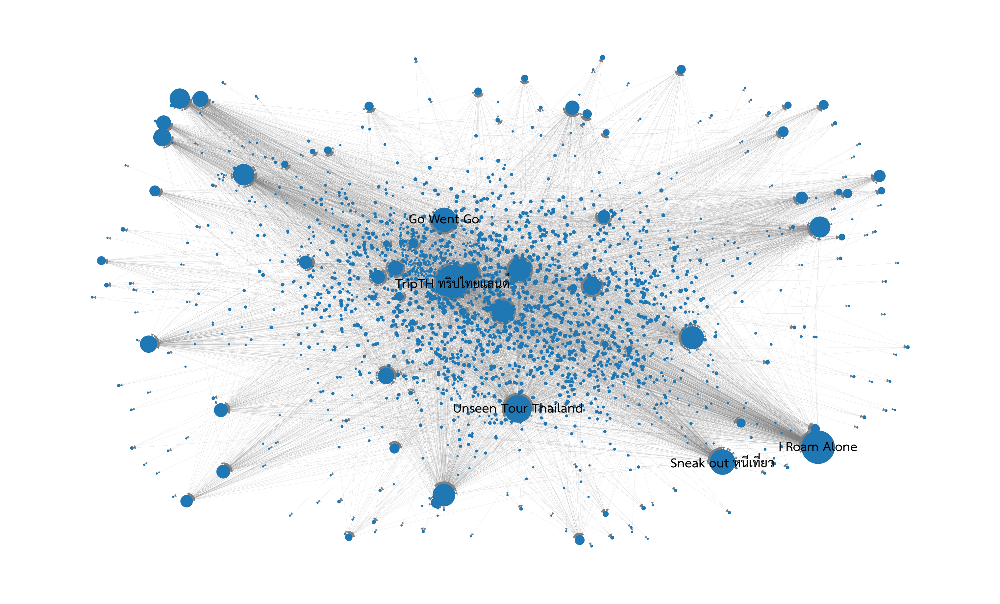

In [23]:
plt.figure(figsize=(15, 9))
# set up nodes size by degree centrality
node_size = [v * 5000 for v in degree_centrality.values()] 
pos = nx.spring_layout(G, iterations=15, seed=42)
nx.draw(
    G, 
    pos, 
    with_labels=False, 
    node_size=node_size, 
    node_color='tab:blue',
    edge_color='gray',
    arrowsize=7, # arrow head length
    width=0.05 # line width
)

# Draw labels only for top degree centrality
top_degree_centrality_label = [n for n, _ in top_degree_centrality]
labels = {node: node if node in top_degree_centrality_label else "" for node in G.nodes}
nx.draw_networkx_labels(
    G, 
    pos, 
    labels=labels, 
    font_size=20, 
    font_color="black", 
    font_weight="heavy", 
    font_family="TH Sarabun New"
);

#### Betweeness Centrality

In [102]:
betweenness_centrality = nx.betweenness_centrality(G) 

# Find top influencers based on degree centrality
top_betweenness_centrality = sorted(betweenness_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print("Top influencers from betweenness centrality:")
top_betweenness_centrality

Top influencers from betweenness centrality:


[('แบกกล้องเที่ยว', 0.013414043061193742),
 ('Go Went Go', 0.010153649774694013),
 ('บันทึกคนขี้เที่ยว', 0.010026708972352038),
 ('Go Went Girls', 0.008349698955945712),
 ('TripTH ทริปไทยแลนด์', 0.008073147453221172)]

In [27]:
pd.Series(betweenness_centrality.values()).describe()

count    2399.000000
mean        0.000035
std         0.000514
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         0.013414
dtype: float64

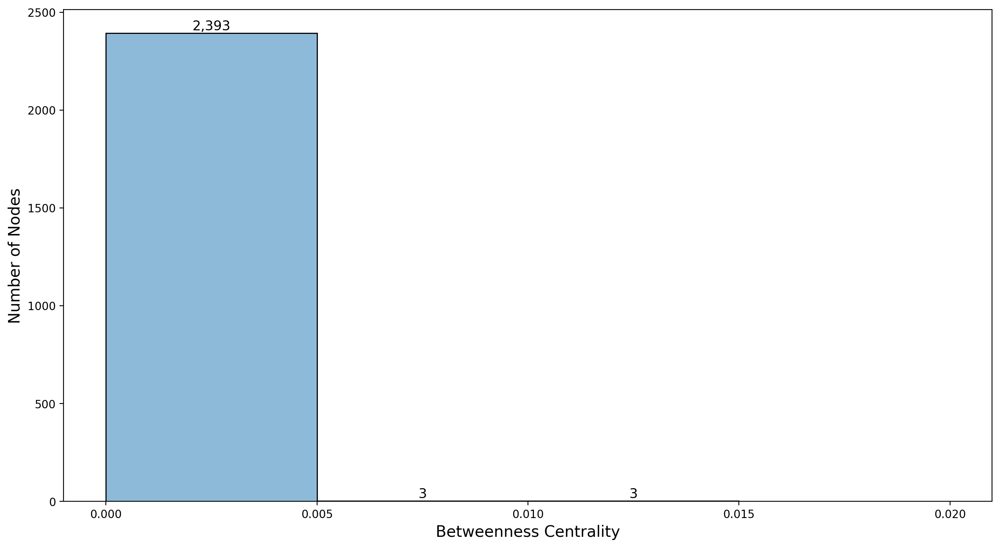

In [98]:
plt.figure(figsize=(15, 8))
ax = sns.histplot(data=betweenness_centrality.values(),
            binrange=(0, 0.02),
            binwidth=0.005)
# Adding value text on each bar
for p in ax.patches:
    height = p.get_height()
    if height > 0:  # Only annotate bars that have a height greater than 0
        ax.text(p.get_x() + p.get_width() / 2, height + 0.5, f'{int(height):,}', 
                ha='center', fontsize=12, color='black', va='bottom')

# Adding a vertical line at x = 0.1
# plt.axvline(x=0.15, color='red', linestyle='--', linewidth=1)

# Setting axis labels
ax.set_xlabel("Betweenness Centrality", fontsize=14)
ax.set_ylabel("Number of Nodes", fontsize=14)
ax.get_legend().remove()

# Setting x-tick labels every 0.05
ax.set_xticks([i * 0.005 for i in range(5)])

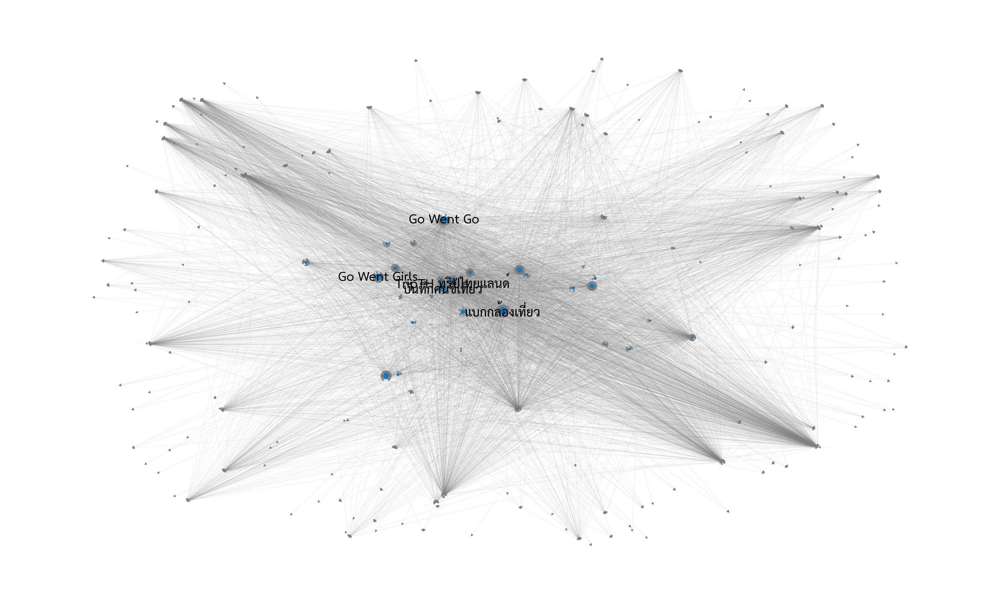

In [33]:
plt.figure(figsize=(15, 9))
# set up nodes size by betweeness centrality
node_size = [v * 5000 for v in betweenness_centrality.values()] 
pos = nx.spring_layout(G, iterations=15, seed=42)
nx.draw(
    G, 
    pos, 
    with_labels=False, 
    node_size=node_size, 
    node_color='tab:blue',
    edge_color='gray',
    arrowsize=7, # arrow head length
    width=0.05 # line width
)

# Draw labels only for top betweeness centrality
top_betweeness_centrality_label = [n for n, _ in top_betweenness_centrality]
labels = {node: node if node in top_betweeness_centrality_label else "" for node in G.nodes}
nx.draw_networkx_labels(
    G, 
    pos, 
    labels=labels, 
    font_size=20, 
    font_color="black", 
    font_weight="heavy", 
    font_family="TH Sarabun New"
);

#### Closeness Centrality

In [34]:
closeness_centrality = nx.closeness_centrality(G) 

# Find top influencers based on degree centrality
top_closeness_centrality = sorted(closeness_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print("Top influencers from closeness centrality:")
top_closeness_centrality

Top influencers from closeness centrality:


[('I Roam Alone', 0.3079395431151976),
 ('Pigkaploy', 0.26646425960667935),
 ('TripTH ทริปไทยแลนด์', 0.24520433694745622),
 ('จ ะ เ ที่ ย ว ไ ป ไ ห น', 0.24367062344880583),
 ('Go Went Go', 0.23991632853165137)]

In [35]:
pd.Series(closeness_centrality.values()).describe()

count    2399.000000
mean        0.008173
std         0.033187
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         0.307940
dtype: float64

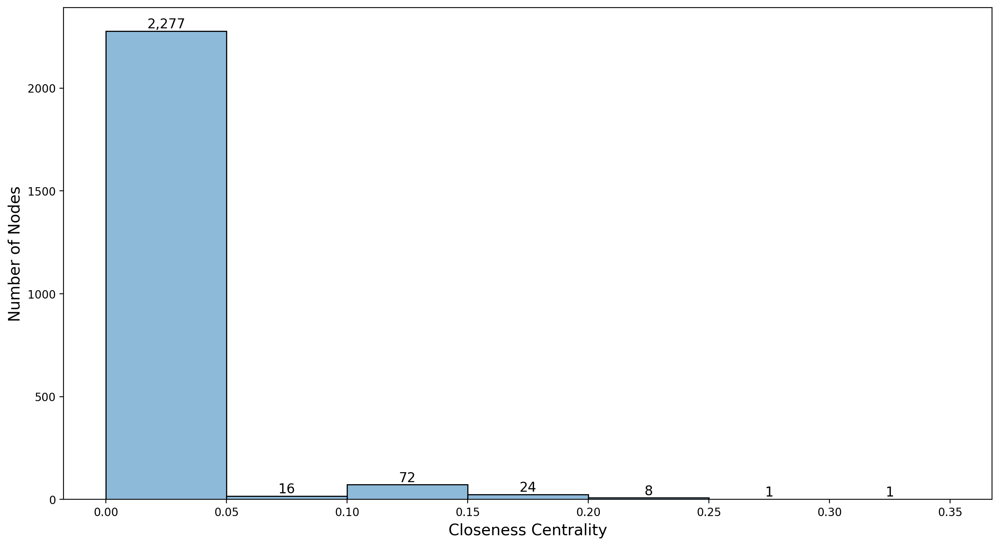

In [99]:
plt.figure(figsize=(15, 8))
ax = sns.histplot(data=closeness_centrality.values(),
            binrange=(0, 0.35),
            binwidth=0.05)
# Adding value text on each bar
for p in ax.patches:
    height = p.get_height()
    if height > 0:  # Only annotate bars that have a height greater than 0
        ax.text(p.get_x() + p.get_width() / 2, height + 0.5, f'{int(height):,}', 
                ha='center', fontsize=12, color='black', va='bottom')

# # Adding a vertical line at x = 0.1
# plt.axvline(x=0.4, color='red', linestyle='--', linewidth=1)

# # Setting axis labels
ax.set_xlabel("Closeness Centrality", fontsize=14)
ax.set_ylabel("Number of Nodes", fontsize=14)
ax.get_legend().remove()

# Setting x-tick labels every 0.05
# ax.set_xticks([i * 0.05 for i in range(13)])

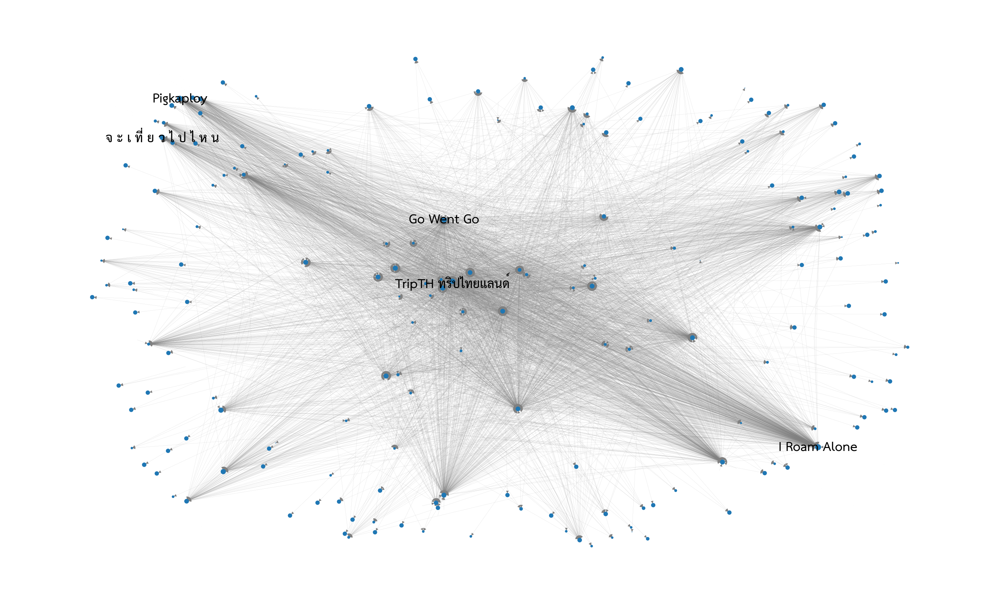

In [38]:
plt.figure(figsize=(15, 9))
# set up nodes size by closeness centrality
node_size = [v * 100 for v in closeness_centrality.values()] 
pos = nx.spring_layout(G, iterations=15, seed=42)
nx.draw(
    G, 
    pos, 
    with_labels=False, 
    node_size=node_size, 
    node_color='tab:blue',
    edge_color='gray',
    arrowsize=7, # arrow head length
    width=0.05 # line width
)

# Draw labels only for top betweeness centrality
top_closeness_centrality_label = [n for n, _ in top_closeness_centrality]
labels = {node: node if node in top_closeness_centrality_label else "" for node in G.nodes}
nx.draw_networkx_labels(
    G, 
    pos, 
    labels=labels, 
    font_size=20, 
    font_color="black", 
    font_weight="heavy", 
    font_family="TH Sarabun New"
);

#### Eigenvector Centrality

In [39]:
eigenvector_centrality = nx.eigenvector_centrality(G) 

# Find top influencers based on eigenvector centrality
top_eigenvector_centrality = sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print("Top influencers from eigenvector centrality:")
top_eigenvector_centrality

Top influencers from eigenvector centrality:


[('Thailand Dive Expo (TDEX)', 0.3656343637852009),
 ('PADI', 0.3625053180004076),
 ('Scuba Jamboree', 0.33360948848288524),
 ('Dive Eat Sleep Thailand', 0.30699152986846934),
 ('digitalay', 0.3037170356831254)]

In [40]:
pd.Series(eigenvector_centrality.values()).describe()

count    2.399000e+03
mean     2.582909e-03
std      2.025685e-02
min      1.753140e-16
25%      1.753140e-16
50%      1.753140e-16
75%      1.753140e-16
max      3.656344e-01
dtype: float64

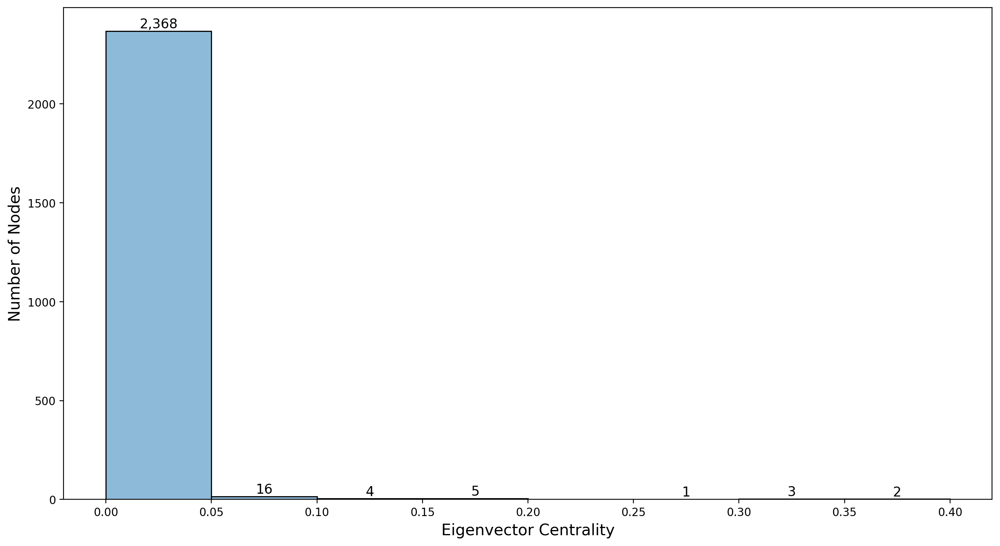

In [101]:
plt.figure(figsize=(15, 8))
ax = sns.histplot(data=eigenvector_centrality.values(),
            binrange=(0, 0.4),
            binwidth=0.05)
# Adding value text on each bar
for p in ax.patches:
    height = p.get_height()
    if height > 0:  # Only annotate bars that have a height greater than 0
        ax.text(p.get_x() + p.get_width() / 2, height + 0.5, f'{int(height):,}', 
                ha='center', fontsize=12, color='black', va='bottom')

# # Adding a vertical line at x = 0.1
# plt.axvline(x=0.4, color='red', linestyle='--', linewidth=1)

# # Setting axis labels
ax.set_xlabel("Eigenvector Centrality", fontsize=14)
ax.set_ylabel("Number of Nodes", fontsize=14)
ax.get_legend().remove()

# Setting x-tick labels every 0.05
# ax.set_xticks([i * 0.05 for i in range(12)])

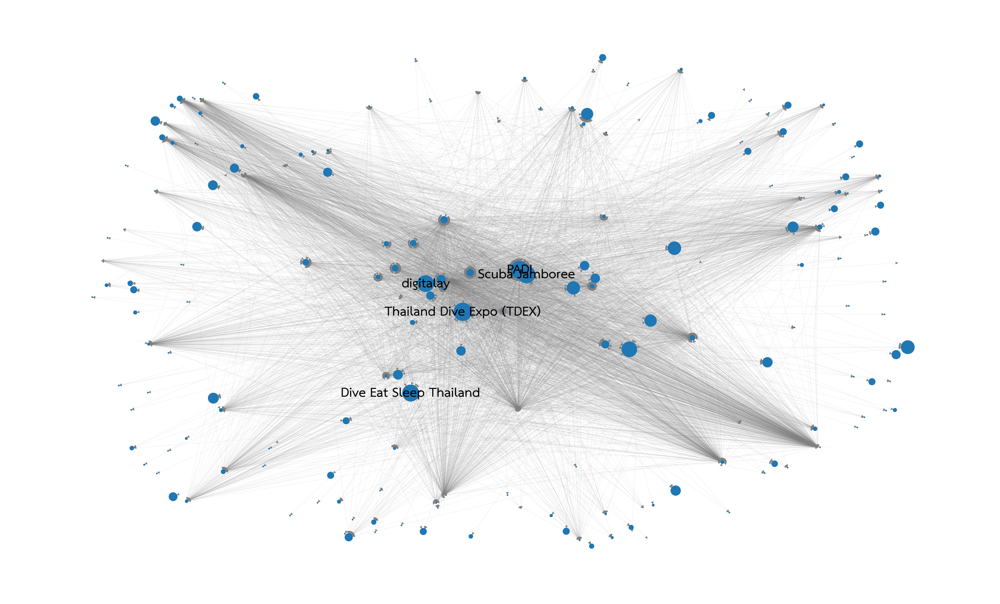

In [43]:
plt.figure(figsize=(15, 9))
# set up nodes size by eigenvector centrality
node_size = [v * 1000 for v in eigenvector_centrality.values()] 
pos = nx.spring_layout(G, iterations=15, seed=42)
nx.draw(
    G, 
    pos, 
    with_labels=False, 
    node_size=node_size, 
    node_color='tab:blue',
    edge_color='gray',
    arrowsize=7, # arrow head length
    width=0.05 # line width
)

# Draw labels only for top betweeness centrality
top_eigenvector_centrality_label = [n for n, _ in top_eigenvector_centrality]
labels = {node: node if node in top_eigenvector_centrality_label else "" for node in G.nodes}
nx.draw_networkx_labels(
    G, 
    pos, 
    labels=labels, 
    font_size=20, 
    font_color="black", 
    font_weight="heavy", 
    font_family="TH Sarabun New"
);

### Community Detection
Apply clustering algorithms to identify tightly connected groups of stakeholders (e.g., followers of specific tourism pages).

In [44]:
# Perform Louvain community detection
communities = nx.community.louvain_communities(G, weight=None, resolution=1.0, seed=42)

In [45]:
len(communities)

25

In [48]:
# Assign community IDs to nodes
community_dict = {node: idx for idx, community in enumerate(communities) for node in community}
nx.set_node_attributes(G, community_dict, "community")

Text(0.5, 1.0, 'Community Detection in Directed Graph (Louvain Method)')

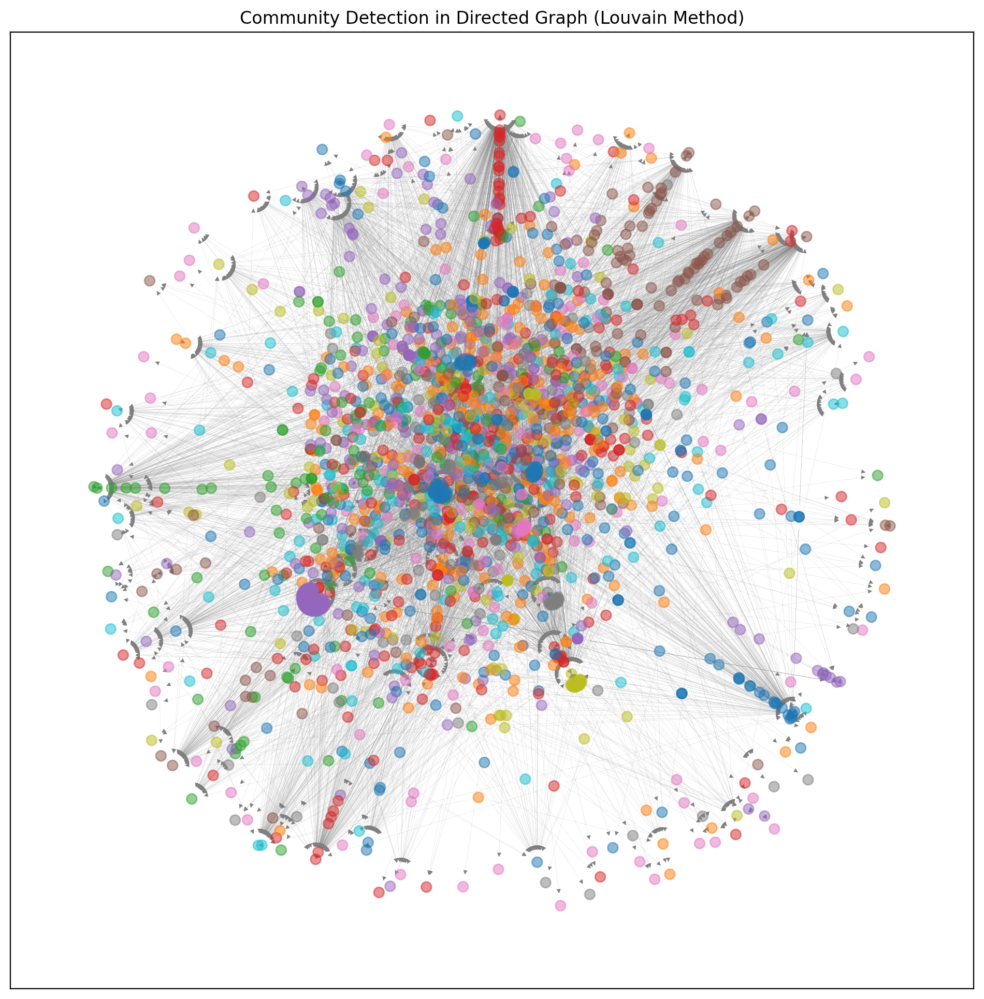

In [52]:
# Visualize the network with communities
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G)
communities_set = set(community_dict.values())
colors = plt.cm.tab10.colors  # Use distinct colors for communities
node_colors = [colors[community_dict[node] % len(colors)] for node in G.nodes]

nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=50, alpha=0.5)
nx.draw_networkx_edges(G, pos, edge_color="gray", width=0.05, arrowsize=7)
# nx.draw_networkx_labels(G, pos, font_size=8, font_color="black", font_weight="bold")
plt.title("Community Detection in Directed Graph (Louvain Method)")

In [60]:
top_central_label = (top_degree_centrality_label +
top_betweeness_centrality_label +
top_closeness_centrality_label +
top_eigenvector_centrality_label)
top_central_label = np.unique(top_central_label)
top_central_label

array(['Dive Eat Sleep Thailand', 'Go Went Girls', 'Go Went Go',
       'I Roam Alone', 'PADI', 'Pigkaploy', 'Scuba Jamboree',
       'Sneak out หนีเที่ยว', 'Thailand Dive Expo (TDEX)',
       'TripTH ทริปไทยแลนด์', 'Unseen Tour Thailand', 'digitalay',
       'จ ะ เ ที่ ย ว ไ ป ไ ห น', 'บันทึกคนขี้เที่ยว', 'แบกกล้องเที่ยว'],
      dtype='<U25')

In [86]:
top_central_label_community = {} 
for l in top_central_label.tolist():
    top_central_label_community[l] = community_dict[l]

top_influ_community_df = pd.DataFrame(top_central_label_community.items())
top_influ_community_df.columns = ['node', 'community']
top_influ_community_df = top_influ_community_df.sort_values('community')
top_influ_community_df

,node,community
13,บันทึกคนขี้เที่ยว,1
5,Pigkaploy,2
3,I Roam Alone,3
12,จ ะ เ ที่ ย ว ไ ป ไ ห น,3
7,Sneak out หนีเที่ยว,5
14,แบกกล้องเที่ยว,6
10,Unseen Tour Thailand,10
0,Dive Eat Sleep Thailand,13
4,PADI,13
6,Scuba Jamboree,13


Text(0.5, 1.0, 'Community Detection in Directed Graph (Louvain Method)')

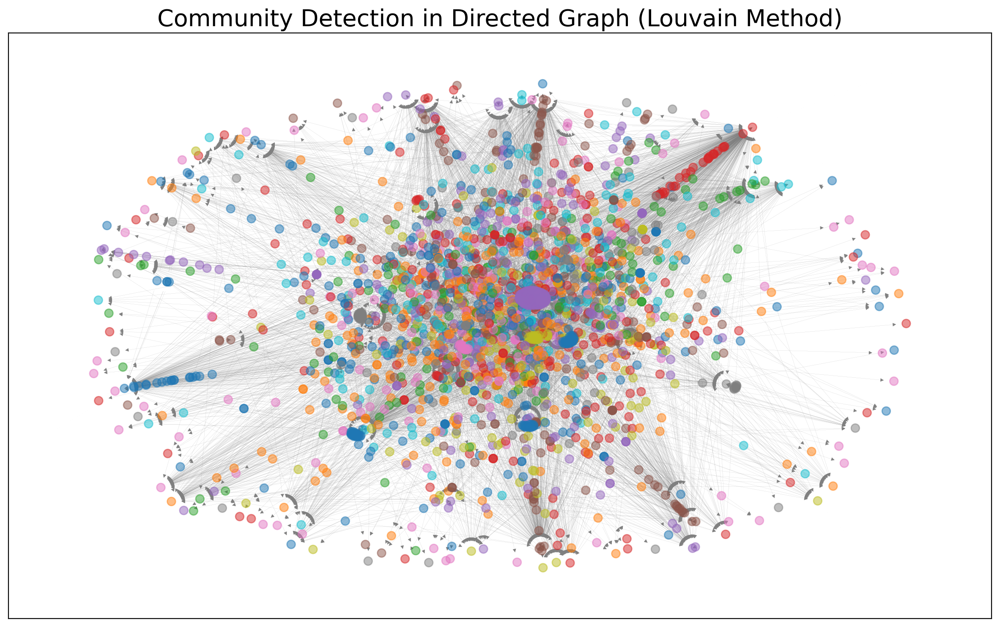

In [92]:
# Visualize the network with communities
plt.figure(figsize=(15, 9), frameon=False)
pos = nx.spring_layout(G)
communities_set = set(community_dict.values())
colors = plt.cm.tab10.colors  # Use distinct colors for communities
node_colors = [colors[community_dict[node] % len(colors)] for node in G.nodes]

nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=50, alpha=0.5)
nx.draw_networkx_edges(G, pos, edge_color="gray", width=0.05, arrowsize=7)
# nx.draw_networkx_labels(G, pos, font_size=8, font_color="black", font_weight="bold")
plt.title("Community Detection in Directed Graph (Louvain Method)")

# Draw labels only for top influencers
labels = {}
colors = {}
for c, n in zip(node_colors, G.nodes):
    if n in top_central_label:
        labels[n] = n
        colors[n] = c
# nx.draw_networkx_labels(
#     G, 
#     pos, 
#     labels=labels, 
#     font_size=20, 
#     font_color=colors, 
#     font_weight="heavy", 
#     font_family="TH Sarabun New",
#     alpha=1
# )

plt.title("Community Detection in Directed Graph (Louvain Method)",
         fontsize=20)